#Data Mining Project Code

#NYPD Crime Arrest Data

#Group 14

#Team Members - 



1.   Mayur Mahanta
2.   Aniket Sakharkar 



#1. Data Collection and Processing
#Importing the Data Set

In [ ]:
import pandas as pd
import numpy as np
from google.colab import files
file = files.upload()  #upload file into google colab session
df = pd.read_csv("NYPD_Arrest_Data__Year_to_Date_.csv")
df

Saving NYPD_Arrest_Data__Year_to_Date_.csv to NYPD_Arrest_Data__Year_to_Date_.csv


,ARREST_KEY,ARREST_DATE,PD_CD,PD_DESC,KY_CD,OFNS_DESC,LAW_CODE,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,New Georeferenced Column
0,238013474,12/18/2021,157.0,RAPE 1,104.0,RAPE,PL 1303501,F,Q,105,97,18-24,M,BLACK,1057636,203954,40.726187,-73.735234,POINT (-73.73523390399998 40.72618713000002)
1,236943583,11/25/2021,263.0,"ARSON 2,3,4",114.0,ARSON,PL 1501500,F,K,69,71,25-44,M,BLACK,1014340,171320,40.636868,-73.891586,POINT (-73.89158591899997 40.63686750900007)
2,234938876,10/14/2021,594.0,OBSCENITY 1,116.0,SEX CRIMES,PL 2631100,F,K,61,0,25-44,M,WHITE,995244,155739,40.594145,-73.960415,POINT (-73.96041495199995 40.59414516900005)
3,234788259,10/11/2021,263.0,"ARSON 2,3,4",114.0,ARSON,PL 1501001,F,B,42,71,18-24,M,BLACK,1009058,239616,40.824340,-73.910365,POINT (-73.91036538099996 40.82433953100008)
4,234188790,09/28/2021,578.0,NaN,NaN,NaN,PL 2223001,M,B,44,0,25-44,M,BLACK,1005169,246667,40.843703,-73.924395,POINT (-73.92439508899997 40.84370255600004)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
155502,222884924,01/10/2021,397.0,"ROBBERY,OPEN AREA UNCLASSIFIED",105.0,ROBBERY,PL 1601001,F,B,46,0,45-64,M,BLACK,1011432,247605,40.846260,-73.901755,POINT (-73.90175529499999 40.846260031000035)
155503,223918625,02/03/2021,792.0,WEAPONS POSSESSION 1 & 2,118.0,DANGEROUS WEAPONS,PL 2650303,F,K,67,0,18-24,M,BLACK,1004940,180941,40.663302,-73.925425,POINT (-73.92542497899994 40.66330200400005)
155504,224323770,02/13/2021,101.0,ASSAULT 3,344.0,ASSAULT 3 & RELATED OFFENSES,PL 1200001,M,S,121,0,45-64,M,BLACK,942825,166367,40.623227,-74.149227,POINT (-74.14922697299994 40.623226819000074)
155505,222599533,01/04/2021,792.0,WEAPONS POSSESSION 1 & 2,118.0,DANGEROUS WEAPONS,PL 2650303,F,K,73,0,25-44,M,BLACK,1007524,188555,40.684194,-73.916085,POINT (-73.91608474599997 40.684194302000044)


In [ ]:
#checking our data dimension
df.shape

(155507, 19)

In [ ]:
#concise summary of our dataset
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 155507 entries, 0 to 155506
Data columns (total 19 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   ARREST_KEY                155507 non-null  int64  
 1   ARREST_DATE               155507 non-null  object 
 2   PD_CD                     155478 non-null  float64
 3   PD_DESC                   155404 non-null  object 
 4   KY_CD                     155404 non-null  float64
 5   OFNS_DESC                 155404 non-null  object 
 6   LAW_CODE                  155507 non-null  object 
 7   LAW_CAT_CD                154114 non-null  object 
 8   ARREST_BORO               155507 non-null  object 
 9   ARREST_PRECINCT           155507 non-null  int64  
 10  JURISDICTION_CODE         155507 non-null  int64  
 11  AGE_GROUP                 155507 non-null  object 
 12  PERP_SEX                  155507 non-null  object 
 13  PERP_RACE                 155507 non-null  o

In [ ]:
#creating a new dataframe to isolated raw data for visualizaition purpose
#and model data for the model building phase
Model_data=df.copy()
Model_data

,ARREST_KEY,ARREST_DATE,PD_CD,PD_DESC,KY_CD,OFNS_DESC,LAW_CODE,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,New Georeferenced Column
0,238013474,12/18/2021,157.0,RAPE 1,104.0,RAPE,PL 1303501,F,Q,105,97,18-24,M,BLACK,1057636,203954,40.726187,-73.735234,POINT (-73.73523390399998 40.72618713000002)
1,236943583,11/25/2021,263.0,"ARSON 2,3,4",114.0,ARSON,PL 1501500,F,K,69,71,25-44,M,BLACK,1014340,171320,40.636868,-73.891586,POINT (-73.89158591899997 40.63686750900007)
2,234938876,10/14/2021,594.0,OBSCENITY 1,116.0,SEX CRIMES,PL 2631100,F,K,61,0,25-44,M,WHITE,995244,155739,40.594145,-73.960415,POINT (-73.96041495199995 40.59414516900005)
3,234788259,10/11/2021,263.0,"ARSON 2,3,4",114.0,ARSON,PL 1501001,F,B,42,71,18-24,M,BLACK,1009058,239616,40.824340,-73.910365,POINT (-73.91036538099996 40.82433953100008)
4,234188790,09/28/2021,578.0,NaN,NaN,NaN,PL 2223001,M,B,44,0,25-44,M,BLACK,1005169,246667,40.843703,-73.924395,POINT (-73.92439508899997 40.84370255600004)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
155502,222884924,01/10/2021,397.0,"ROBBERY,OPEN AREA UNCLASSIFIED",105.0,ROBBERY,PL 1601001,F,B,46,0,45-64,M,BLACK,1011432,247605,40.846260,-73.901755,POINT (-73.90175529499999 40.846260031000035)
155503,223918625,02/03/2021,792.0,WEAPONS POSSESSION 1 & 2,118.0,DANGEROUS WEAPONS,PL 2650303,F,K,67,0,18-24,M,BLACK,1004940,180941,40.663302,-73.925425,POINT (-73.92542497899994 40.66330200400005)
155504,224323770,02/13/2021,101.0,ASSAULT 3,344.0,ASSAULT 3 & RELATED OFFENSES,PL 1200001,M,S,121,0,45-64,M,BLACK,942825,166367,40.623227,-74.149227,POINT (-74.14922697299994 40.623226819000074)
155505,222599533,01/04/2021,792.0,WEAPONS POSSESSION 1 & 2,118.0,DANGEROUS WEAPONS,PL 2650303,F,K,73,0,25-44,M,BLACK,1007524,188555,40.684194,-73.916085,POINT (-73.91608474599997 40.684194302000044)


In [ ]:
# Importing LabelEncoder from Sklearn
# library from preprocessing Module.
from sklearn.preprocessing import LabelEncoder
 
# Creating a instance of label Encoder.
le = LabelEncoder()
 
# Using .fit_transform function to fit label
# encoder and return encoded label
label = le.fit_transform(Model_data['PERP_SEX'])
 
# printing label
label


array([1, 1, 1, ..., 1, 1, 1])

In [ ]:
# removing the column 'Purchased' from df
# as it is of no use now.
Model_data.drop("PERP_SEX", axis=1, inplace=True)
 
# Appending the array to our dataFrame
# with column name 'Purchased'
Model_data["PERP_SEX"] = label

In [ ]:
# Importing LabelEncoder from Sklearn
# library from preprocessing Module.
from sklearn.preprocessing import LabelEncoder
 
# Creating a instance of label Encoder.
le1 = LabelEncoder()
 
# Using .fit_transform function to fit label
# encoder and return encoded label
label1 = le1.fit_transform(Model_data['PERP_RACE'])
 
# printing label
label1

array([2, 2, 5, ..., 2, 2, 1])

In [ ]:
# removing the column 'Purchased' from df
# as it is of no use now.
Model_data.drop("PERP_RACE", axis=1, inplace=True)
 
# Appending the array to our dataFrame
# with column name 'Purchased'
Model_data["PERP_RACE"] = label1

In [ ]:
# Importing LabelEncoder from Sklearn
# library from preprocessing Module.
from sklearn.preprocessing import LabelEncoder
 
# Creating a instance of label Encoder.
le2 = LabelEncoder()
 
# Using .fit_transform function to fit label
# encoder and return encoded label
label2 = le2.fit_transform(Model_data['AGE_GROUP'])
 
# printing label
label2

array([0, 1, 1, ..., 2, 1, 0])

In [ ]:
# removing the column 'Purchased' from df
# as it is of no use now.
Model_data.drop("AGE_GROUP", axis=1, inplace=True)
 
# Appending the array to our dataFrame
# with column name 'Purchased'
Model_data["AGE_GROUP"] = label2

In [ ]:
# Importing LabelEncoder from Sklearn
# library from preprocessing Module.
from sklearn.preprocessing import LabelEncoder
 
# Creating a instance of label Encoder.
le3 = LabelEncoder()
 
# Using .fit_transform function to fit label
# encoder and return encoded label
label3 = le3.fit_transform(Model_data['ARREST_BORO'])
 
# printing label
label3

array([3, 1, 1, ..., 4, 1, 3])

In [ ]:
# removing the column 'Purchased' from df
# as it is of no use now.
Model_data.drop("ARREST_BORO", axis=1, inplace=True)
 
# Appending the array to our dataFrame
# with column name 'Purchased'
Model_data["ARREST_BORO"] = label3

In [ ]:
# Importing LabelEncoder from Sklearn
# library from preprocessing Module.
from sklearn.preprocessing import LabelEncoder
 
# Creating a instance of label Encoder.
le4 = LabelEncoder()
 
# Using .fit_transform function to fit label
# encoder and return encoded label
label4 = le4.fit_transform(Model_data['OFNS_DESC'])
 
# printing label
label4

array([56,  5, 58, ...,  6, 13, 10])

In [ ]:
# removing the column 'Purchased' from df
# as it is of no use now.
Model_data.drop("OFNS_DESC", axis=1, inplace=True)
 
# Appending the array to our dataFrame
# with column name 'Purchased'
Model_data["OFNS_DESC"] = label4

In [ ]:
# Importing LabelEncoder from Sklearn
# library from preprocessing Module.
from sklearn.preprocessing import LabelEncoder
 
# Creating a instance of label Encoder.
le5 = LabelEncoder()
 
# Using .fit_transform function to fit label
# encoder and return encoded label
label5 = le5.fit_transform(Model_data['PD_DESC'])
 
# printing label
label5

array([175,  12, 148, ...,  14, 235,  51])

In [ ]:
# removing the column 'Purchased' from df
# as it is of no use now.
Model_data.drop("PD_DESC", axis=1, inplace=True)
 
# Appending the array to our dataFrame
# with column name 'Purchased'
Model_data["PD_DESC"] = label5

In [ ]:
# Importing LabelEncoder from Sklearn
# library from preprocessing Module.
from sklearn.preprocessing import LabelEncoder
 
# Creating a instance of label Encoder.
le6 = LabelEncoder()
 
# Using .fit_transform function to fit label
# encoder and return encoded label
label6 = le6.fit_transform(Model_data['LAW_CODE'])
 
# printing label
label6

array([248, 373, 801, ...,  95, 822, 354])

In [ ]:
# removing the column 'Purchased' from df
# as it is of no use now.
Model_data.drop("LAW_CODE", axis=1, inplace=True)
 
# Appending the array to our dataFrame
# with column name 'Purchased'
Model_data["LAW_CODE"] = label6

In [ ]:
# Importing LabelEncoder from Sklearn
# library from preprocessing Module.
from sklearn.preprocessing import LabelEncoder
 
# Creating a instance of label Encoder.
le7 = LabelEncoder()
 
# Using .fit_transform function to fit label
# encoder and return encoded label
label7 = le7.fit_transform(Model_data['LAW_CAT_CD'])
 
# printing label
label7
# removing the column 'Purchased' from df
# as it is of no use now.
Model_data.drop("LAW_CAT_CD", axis=1, inplace=True)
 
# Appending the array to our dataFrame
# with column name 'Purchased'
Model_data["LAW_CAT_CD"] = label7

In [ ]:
# Importing LabelEncoder from Sklearn
# library from preprocessing Module.
from sklearn.preprocessing import LabelEncoder
 
# Creating a instance of label Encoder.
le8 = LabelEncoder()
 
# Using .fit_transform function to fit label
# encoder and return encoded label
label8 = le8.fit_transform(Model_data['New Georeferenced Column'])
 
# printing label
label8
# removing the column 'Purchased' from df
# as it is of no use now.
Model_data.drop("New Georeferenced Column", axis=1, inplace=True)
 
# Appending the array to our dataFrame
# with column name 'Purchased'
Model_data["New Georeferenced Column"] = label8

In [ ]:
# Importing LabelEncoder from Sklearn
# library from preprocessing Module.
from sklearn.preprocessing import LabelEncoder
 
# Creating a instance of label Encoder.
le9 = LabelEncoder()
 
# Using .fit_transform function to fit label
# encoder and return encoded label
label9 = le9.fit_transform(Model_data['ARREST_DATE'])
 
# printing label
label9
# removing the column 'Purchased' from df
# as it is of no use now.
Model_data.drop("ARREST_DATE", axis=1, inplace=True)
 
# Appending the array to our dataFrame
# with column name 'Purchased'
Model_data["ARREST_DATE"] = label9

In [ ]:
#model data after label encoding (Converting Categorical to Numerical Data)
Model_data

,ARREST_KEY,PD_CD,KY_CD,ARREST_PRECINCT,JURISDICTION_CODE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,PERP_SEX,PERP_RACE,AGE_GROUP,ARREST_BORO,OFNS_DESC,PD_DESC,LAW_CODE,LAW_CAT_CD,New Georeferenced Column,ARREST_DATE
0,238013474,157.0,104.0,105,97,1057636,203954,40.726187,-73.735234,1,2,0,3,56,175,248,0,243,351
1,236943583,263.0,114.0,69,71,1014340,171320,40.636868,-73.891586,1,2,1,1,5,12,373,0,11340,328
2,234938876,594.0,116.0,61,0,995244,155739,40.594145,-73.960415,1,5,1,1,58,148,801,0,24550,286
3,234788259,263.0,114.0,42,71,1009058,239616,40.824340,-73.910365,1,2,0,0,5,12,372,0,14848,283
4,234188790,578.0,NaN,44,0,1005169,246667,40.843703,-73.924395,1,2,1,0,63,241,685,2,17732,270
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
155502,222884924,397.0,105.0,46,0,1011432,247605,40.846260,-73.901755,1,2,2,0,57,188,410,0,13075,9
155503,223918625,792.0,118.0,67,0,1004940,180941,40.663302,-73.925425,1,2,0,1,13,235,822,0,17923,33
155504,224323770,101.0,344.0,121,0,942825,166367,40.623227,-74.149227,1,2,2,4,6,14,95,2,33392,43
155505,222599533,792.0,118.0,73,0,1007524,188555,40.684194,-73.916085,1,2,1,1,13,235,822,0,16018,3


#2. Data Exploration and Visualization

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7faf2b65dcd0>,
      dtype=object)

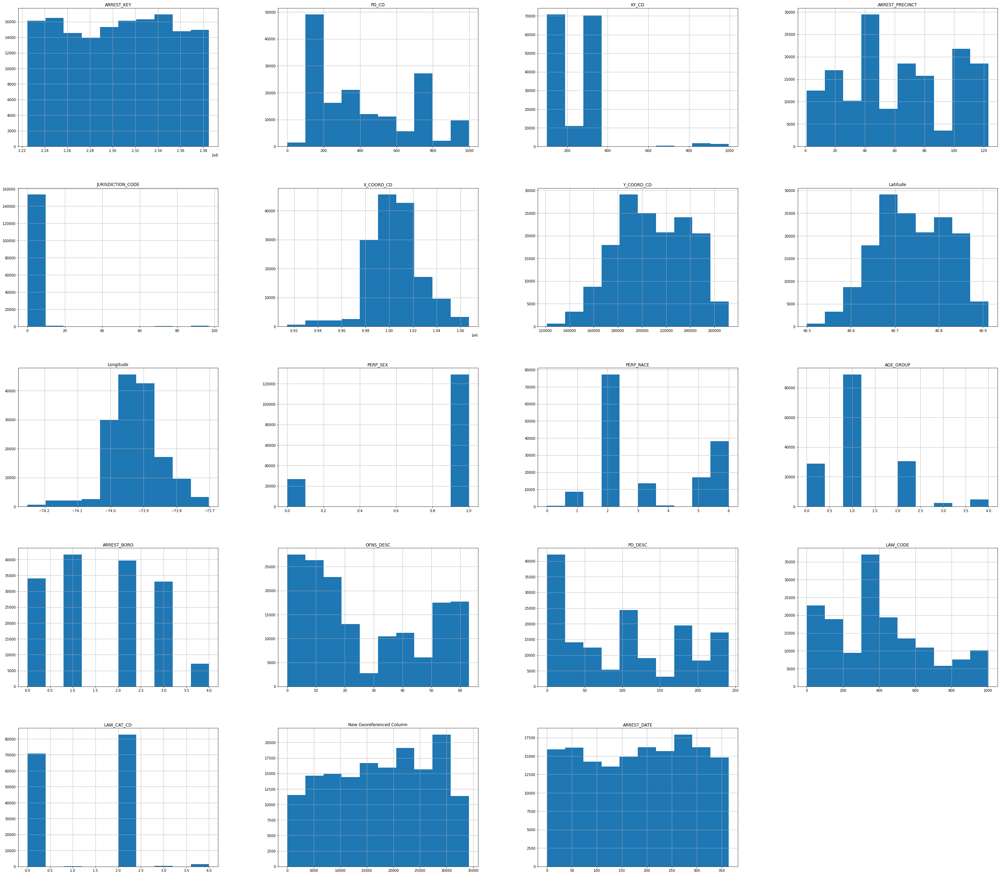

In [ ]:
#plotting histogram to understand individiual variable distribution
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
Model_data.hist(figsize = (50,45))

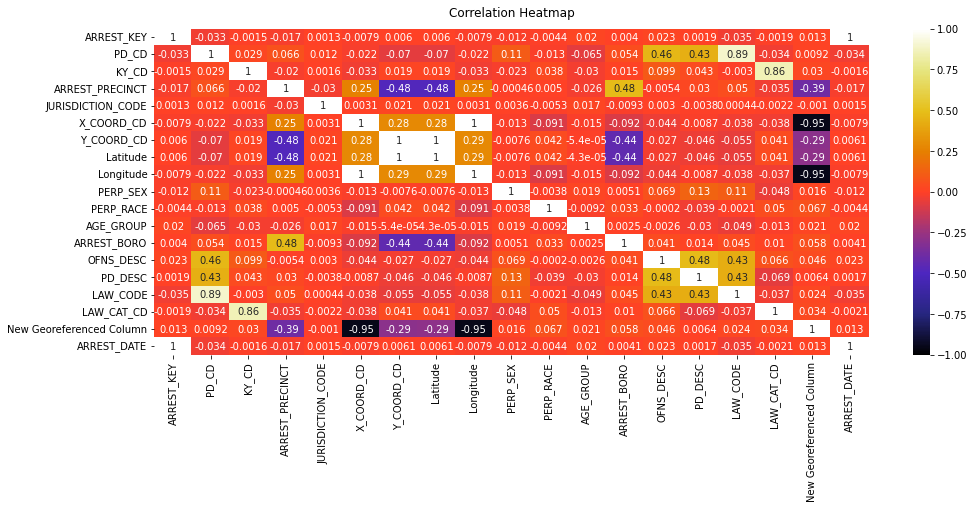

In [ ]:
#plotting the heatmap on data without standardization
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
# Increase the size of the heatmap.
plt.figure(figsize=(16, 6))
# Store heatmap object in a variable to easily access it when you want to include more features (such as title).
# Set the range of values to be displayed on the colormap from -1 to 1, and set the annotation to True to display the correlation values on the heatmap.
heatmap = sns.heatmap(Model_data.corr(), vmin=-1, vmax=1, annot=True, cmap='CMRmap')
# Give a title to the heatmap. Pad defines the distance of the title from the top of the heatmap.
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':12}, pad=12);

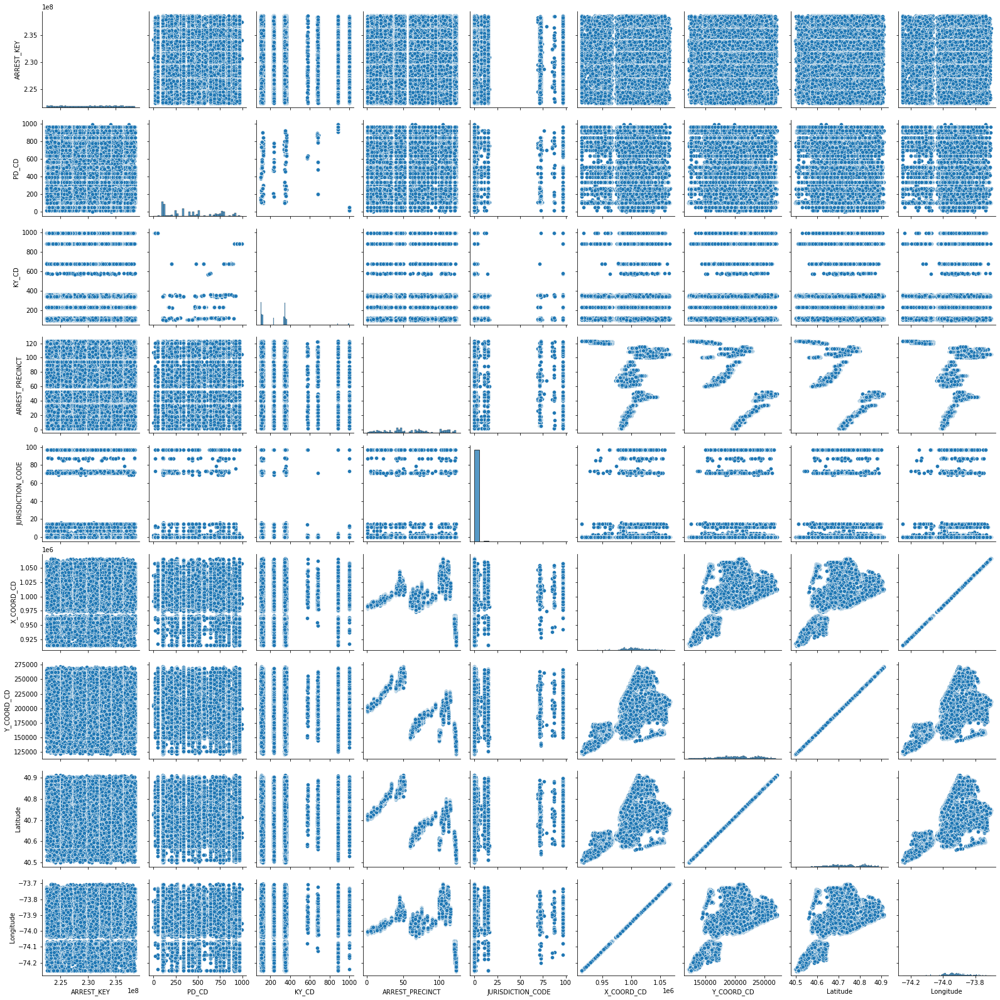

In [ ]:
#plotting a scatterplot matrix on the original raw data frame
import seaborn as sns
import matplotlib.pyplot as plt
sns.pairplot(df)

In [ ]:
#plotting a pie chart to visualize the type of races involved in crime and their frequency
import plotly.express as px
fig = px.pie(df,values='ARREST_PRECINCT', names='PERP_RACE',)
fig.update_traces(pull=[0.1,0.1, 0.1, 0,0,0,0])

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



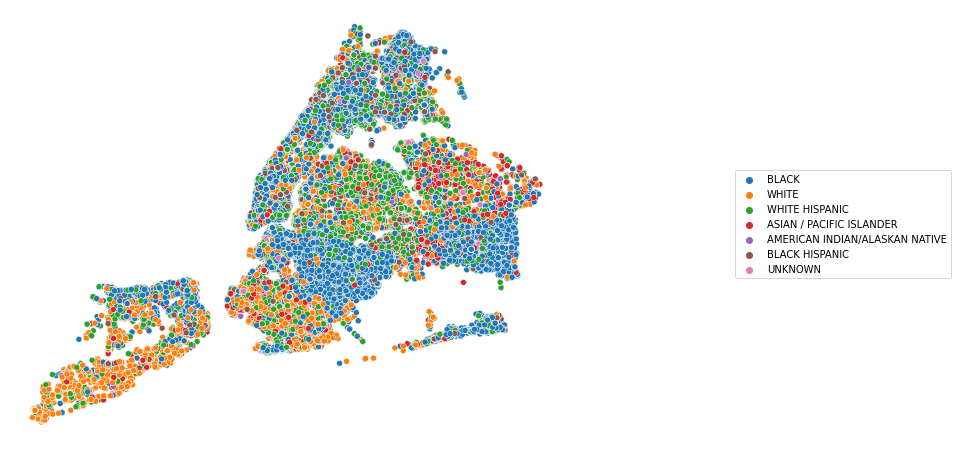

In [ ]:
#plotting a scatter plot on the map of new york with our race variable
fig, ax = plt.subplots(figsize = (10,8))

# set theft type as scatterplot color
sns.scatterplot(df['Longitude'],df['Latitude'], marker = 'o', 
                hue = df['PERP_RACE'], ax = ax)
ax.legend(loc = 'center right', bbox_to_anchor=(1.7, 0.5), ncol=1) 

ax.axis('off')
plt.show()

In [ ]:
#plotting the scatter map box to understand the races and age - group involved
#in the crimes around the vicinity of New York (Demographics shown)
def animate_map(time_col):
    fig = px.scatter_mapbox(df,
              lat="Latitude" ,
              lon="Longitude",
              hover_name=df['PERP_RACE'],
              color=df['AGE_GROUP'],
              animation_frame=time_col,
              mapbox_style='carto-positron',
              category_orders={
              time_col:list(np.sort(df[time_col].unique()))
              },                  
              zoom=10)
    fig.show();
animate_map(time_col='ARREST_DATE')

In [ ]:
#taking our target variable and storing it in y or output set
y= Model_data.AGE_GROUP
#consecutively, dropping the target variable or input set
x=Model_data.drop('AGE_GROUP',axis=1)

In [ ]:
#checking groups in our target variable
y

0         0
1         1
2         1
3         0
4         1
         ..
155502    2
155503    0
155504    2
155505    1
155506    0
Name: AGE_GROUP, Length: 155507, dtype: int64

In [ ]:
#dropping the variables with comparitively higher negative correlation
x.drop(['X_COORD_CD','Y_COORD_CD','Latitude','Longitude','PD_DESC','LAW_CODE','LAW_CAT_CD'],axis=1)

,ARREST_KEY,PD_CD,KY_CD,ARREST_PRECINCT,JURISDICTION_CODE,PERP_SEX,PERP_RACE,ARREST_BORO,OFNS_DESC,New Georeferenced Column,ARREST_DATE
0,238013474,157.0,104.0,105,97,1,2,3,56,243,351
1,236943583,263.0,114.0,69,71,1,2,1,5,11340,328
2,234938876,594.0,116.0,61,0,1,5,1,58,24550,286
3,234788259,263.0,114.0,42,71,1,2,0,5,14848,283
4,234188790,578.0,NaN,44,0,1,2,0,63,17732,270
...,...,...,...,...,...,...,...,...,...,...,...
155502,222884924,397.0,105.0,46,0,1,2,0,57,13075,9
155503,223918625,792.0,118.0,67,0,1,2,1,13,17923,33
155504,224323770,101.0,344.0,121,0,1,2,4,6,33392,43
155505,222599533,792.0,118.0,73,0,1,2,1,13,16018,3


In [ ]:
#checking for null values in our input set
x.isnull().sum()

ARREST_KEY                    0
PD_CD                        29
KY_CD                       103
ARREST_PRECINCT               0
JURISDICTION_CODE             0
X_COORD_CD                    0
Y_COORD_CD                    0
Latitude                      0
Longitude                     0
PERP_SEX                      0
PERP_RACE                     0
ARREST_BORO                   0
OFNS_DESC                     0
PD_DESC                       0
LAW_CODE                      0
LAW_CAT_CD                    0
New Georeferenced Column      0
ARREST_DATE                   0
dtype: int64

In [ ]:
#forward filling varables where the missing values were found
x['PD_CD'].fillna(method='ffill',inplace= True)
x['KY_CD'].fillna(method='ffill',inplace= True)

In [ ]:
#rechcking to confirm no missing values are present
x.isnull().sum()

ARREST_KEY                  0
PD_CD                       0
KY_CD                       0
ARREST_PRECINCT             0
JURISDICTION_CODE           0
X_COORD_CD                  0
Y_COORD_CD                  0
Latitude                    0
Longitude                   0
PERP_SEX                    0
PERP_RACE                   0
ARREST_BORO                 0
OFNS_DESC                   0
PD_DESC                     0
LAW_CODE                    0
LAW_CAT_CD                  0
New Georeferenced Column    0
ARREST_DATE                 0
dtype: int64

In [ ]:
#rescaling our input data set
from sklearn.decomposition import PCA
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
data_normalized = preprocessing.scale(x)
data_normalized

array([[ 1.6304805 , -0.90969591, -0.93763902, ..., -1.07261937,
        -1.87607221,  1.58713196],
       [ 1.39930331, -0.52527983, -0.87111756, ..., -1.07261937,
        -0.69197955,  1.36884794],
       [ 0.96613533,  0.67511375, -0.85781327, ..., -1.07261937,
         0.71757835,  0.97024235],
       ...,
       [-1.32752854, -1.11278364,  0.65887608, ...,  0.86442455,
         1.66105382, -1.33597572],
       [-1.70009384,  1.39317396, -0.84450897, ..., -1.07261937,
        -0.19281892, -1.7156001 ],
       [-1.38519671, -0.507147  , -0.82455254, ..., -1.07261937,
        -1.38672834, -1.40240999]])

In [ ]:
#data after standardization
standardized_final_data=pd.DataFrame(data=data_normalized, columns = x.columns)
standardized_final_data

,ARREST_KEY,PD_CD,KY_CD,ARREST_PRECINCT,JURISDICTION_CODE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,PERP_SEX,PERP_RACE,ARREST_BORO,OFNS_DESC,PD_DESC,LAW_CODE,LAW_CAT_CD,New Georeferenced Column,ARREST_DATE
0,1.630480,-0.909696,-0.937639,1.195448,12.171946,2.445133,-0.140764,-0.143842,2.445638,0.454227,-0.742541,1.190968,1.479490,0.959686,-0.628739,-1.072619,-1.876072,1.587132
1,1.399303,-0.525280,-0.871118,0.174417,8.878379,0.434042,-1.232046,-1.231973,0.431830,0.454227,-0.742541,-0.511117,-1.158436,-1.174062,-0.137556,-1.072619,-0.691980,1.368848
2,0.966135,0.675114,-0.857813,-0.052479,-0.115590,-0.452963,-1.753075,-1.752436,-0.454685,0.454227,0.915658,-0.511117,1.582938,0.606243,1.544255,-1.072619,0.717578,0.970242
3,0.933591,-0.525280,-0.871118,-0.591356,8.878379,0.188695,1.051774,1.051894,0.189951,0.454227,-0.742541,-1.362159,-1.158436,-1.174062,-0.141486,-1.072619,-0.317662,0.941771
4,0.804060,0.617089,-0.871118,-0.534632,-0.115590,0.008051,1.287559,1.287783,0.009249,0.454227,-0.742541,-1.362159,1.841558,1.823657,1.088437,0.864425,-0.009929,0.818393
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
155502,-1.638428,-0.039320,-0.930987,-0.477908,-0.115590,0.298967,1.318926,1.318939,0.300849,0.454227,-0.742541,-1.362159,1.531214,1.129862,0.007834,-1.072619,-0.506848,-1.658656
155503,-1.415070,1.393174,-0.844509,0.117693,-0.115590,-0.002586,-0.910320,-0.909937,-0.004016,0.454227,-0.742541,-0.511117,-0.744644,1.745115,1.626774,-1.072619,0.010452,-1.430882
155504,-1.327529,-1.112784,0.658876,1.649239,-0.115590,-2.887814,-1.397674,-1.398150,-2.886577,0.454227,-0.742541,2.042010,-1.106712,-1.147881,-1.229948,0.864425,1.661054,-1.335976
155505,-1.700094,1.393174,-0.844509,0.287865,-0.115590,0.117441,-0.655707,-0.655417,0.116286,0.454227,-0.742541,-0.511117,-0.744644,1.745115,1.626774,-1.072619,-0.192819,-1.715600


In [ ]:
#applying PCA on our standardized data
principle_component_A=PCA()

#we are fitting or accepting the input data or df5 and storing in principle_component_A
principle_component_A.fit(standardized_final_data)

#using fit_transform, we are scaling the training data and also learn the scaling parameters of that data. (learning the mean, variance, etc.)
principle_data=principle_component_A.transform(standardized_final_data)
PCA_DATA=pd.DataFrame(data=principle_data, columns = standardized_final_data.columns)
PCA_DATA

,ARREST_KEY,PD_CD,KY_CD,ARREST_PRECINCT,JURISDICTION_CODE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,PERP_SEX,PERP_RACE,ARREST_BORO,OFNS_DESC,PD_DESC,LAW_CODE,LAW_CAT_CD,New Georeferenced Column,ARREST_DATE
0,-2.959468,2.278284,1.695465,2.610111,-0.846083,4.141588,11.448890,-0.170720,2.308686,-0.491224,-0.497058,-0.276173,-0.187048,-0.369493,-0.377967,0.033283,0.002152,0.000573
1,-0.338263,-0.309677,1.892033,1.902092,-1.344816,3.491096,8.263659,-0.126690,-0.798950,1.349479,-0.208688,-0.149060,0.004651,-0.386246,0.370648,0.022958,-0.001043,-0.000093
2,2.378596,1.823712,-0.274508,1.519299,-1.328379,-0.587981,0.054228,-0.084043,0.340029,1.649188,-0.962843,-0.412779,-0.162905,-0.648017,-0.033949,-0.003599,0.000488,-0.000268
3,-1.733444,-1.755719,-0.553345,1.174943,-1.709372,3.260653,8.251352,-0.094811,-0.861820,0.400374,0.016484,0.629221,0.060142,-0.361668,0.051709,-0.004180,-0.000322,0.000152
4,-0.703551,0.977286,-3.135670,1.299498,-0.360595,0.702550,-0.476415,-0.173638,0.980928,0.004614,-0.132060,0.750862,-1.371013,0.215914,-0.109104,-0.010828,-0.000326,0.000272
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
155502,-1.555838,0.542697,-1.994243,-2.189251,-1.629370,0.678629,-0.453747,-0.268552,1.493152,-0.078867,-0.466457,0.707029,0.020293,-0.078198,0.090684,0.014594,-0.000183,0.000110
155503,0.901063,2.279534,-0.426027,-1.889839,-1.622161,0.790900,-0.376171,-0.118053,-0.573192,1.024808,1.475980,-0.235635,-0.099250,-0.056257,0.065170,0.010274,-0.000317,-0.000154
155504,4.465284,-1.836051,2.492806,-2.075730,1.128293,0.504836,-0.145937,-0.749383,-0.394811,-1.622065,0.273391,1.391895,-0.011073,0.121134,0.514573,0.006902,-0.000317,0.000636
155505,0.510484,2.372758,-0.480865,-2.284894,-1.605007,0.723015,-0.359286,-0.119899,-0.560195,0.856714,1.507154,-0.045657,-0.094887,-0.056712,0.072304,0.010116,-0.000482,-0.000116


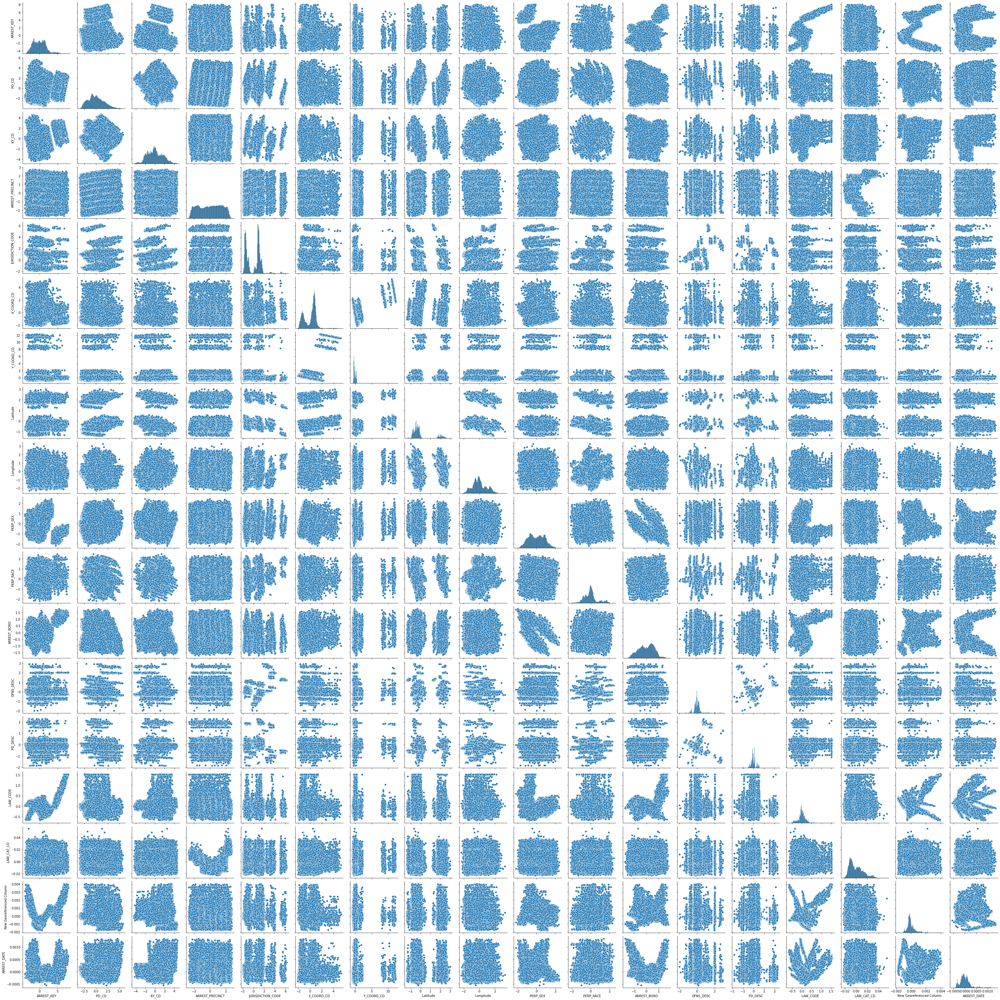

In [ ]:
#plotting a scatter plot matrix on our PCA applied dataset to check for pairwwise relationship between variables
import seaborn as sns
import matplotlib.pyplot as plt
sns.pairplot(PCA_DATA)

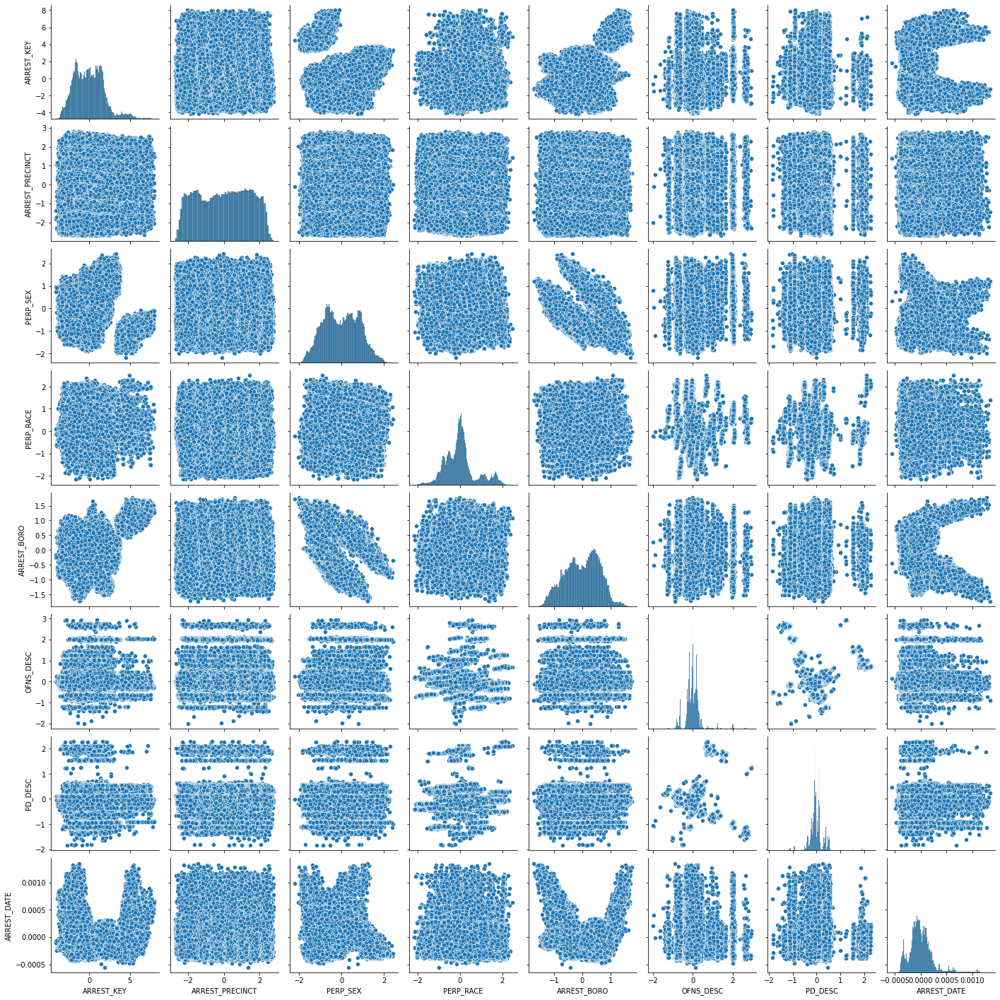

In [ ]:
#plotting the scatter plot matrix for a few relevant variables
sns.pairplot(PCA_DATA, vars = PCA_DATA.iloc[:,[0,3,9,10,11,12,13,17]])


				 Displaying the box plots of the relevant variables along with the outliers 




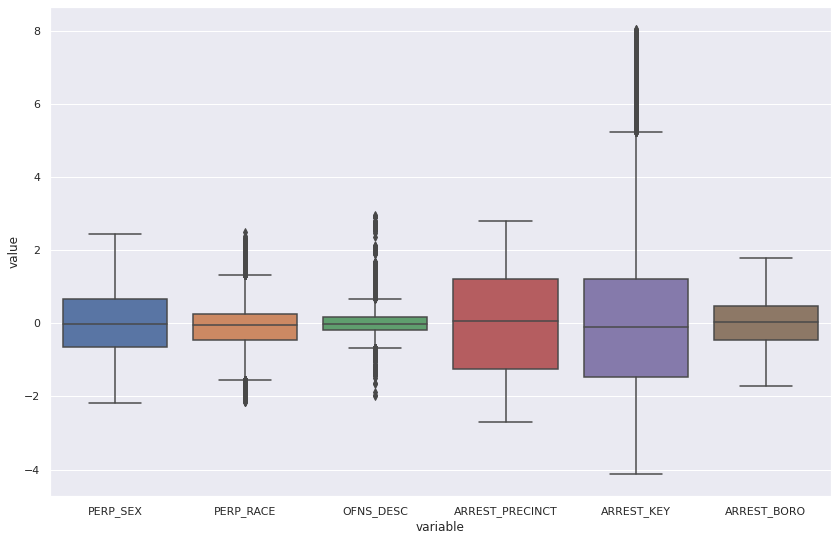

In [ ]:
#plotting a side - by - side box plot on our PCA applied data for a few relevant variables
import numpy as np; np.random.seed(42)
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

print("\n\t\t\t\t Displaying the box plots of the relevant variables along with the outliers \n\n")
boxplot_data = pd.DataFrame(data = PCA_DATA, columns = ['PERP_SEX','PERP_RACE','OFNS_DESC','ARREST_PRECINCT','ARREST_KEY','ARREST_BORO'])

sns.set(rc={'figure.figsize':(14,9)}) 
sns.boxplot(x="variable", y="value", data=pd.melt(boxplot_data))

plt.show()


					 Displaying the box plots of the relevant variables without the outliers 




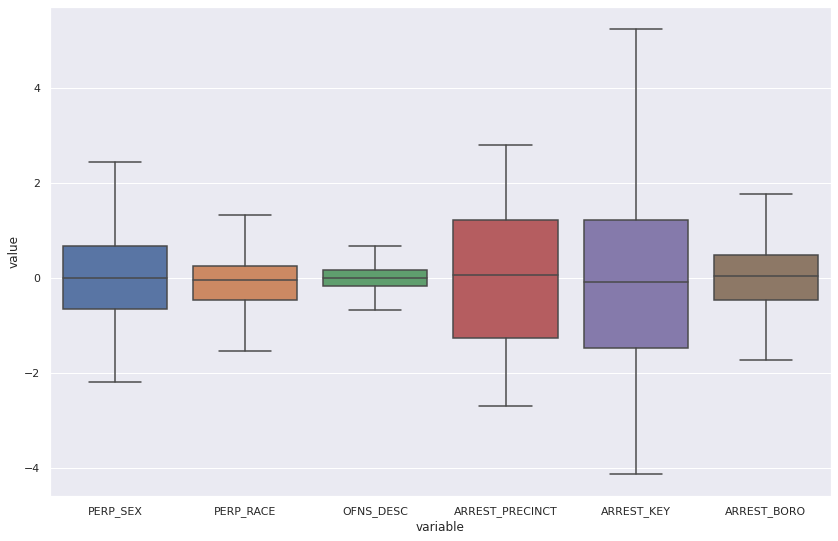




	 As we can see that the variables have different distributions, they can be considered as good predictors 



In [ ]:
#plotting the same side - by - side box plot wihtout the outliers
print("\n\t\t\t\t\t Displaying the box plots of the relevant variables without the outliers \n\n")
boxplot_data = pd.DataFrame(data =PCA_DATA, columns = ['PERP_SEX','PERP_RACE','OFNS_DESC','ARREST_PRECINCT','ARREST_KEY','ARREST_BORO'])

sns.set(rc={'figure.figsize':(14,9)}) 
sns.boxplot(x="variable", y="value", data=pd.melt(boxplot_data), showfliers = False)

plt.show()

print("\n\n\n\t As we can see that the variables have different distributions, they can be considered as good predictors \n")

#3. Model Building, Exploration and Selection

In [ ]:
#Splitting the dataset into training and testing variables with 75:25 ratio
from sklearn.model_selection import train_test_split
 
x_train, x_test, y_train, y_test = train_test_split(standardized_final_data, y, test_size=0.25,random_state=500)
 
#printing shapes of testing and training sets :
print("shape of original dataset :", standardized_final_data.shape)
print("shape of input - training set", x_train.shape)
print("shape of output - training set", y_train.shape)
print("shape of input - testing set", x_test.shape)
print("shape of output - testing set", y_test.shape)

shape of original dataset : (155507, 18)
shape of input - training set (116630, 18)
shape of output - training set (116630,)
shape of input - testing set (38877, 18)
shape of output - testing set (38877,)


In [ ]:
#cross validation score for Decision Tree Classifier
from sklearn.model_selection import cross_val_score
from sklearn.tree import DecisionTreeClassifier
clf_dc = DecisionTreeClassifier(max_depth=3)
clf_dc = clf_dc.fit(x_train, y_train)
cross_val_score(clf_dc, x_train, y_train, cv=10)

array([0.57035068, 0.57035068, 0.57026494, 0.57026494, 0.57026494,
       0.57026494, 0.57026494, 0.57026494, 0.57026494, 0.57026494])

In [ ]:
#checking accuracy for decision tree
decision_tree = DecisionTreeClassifier(max_depth=3,random_state=42)
decision_tree.fit(x_train, y_train)
acc_decision_tree = round(decision_tree.score(x_test, y_test) * 100, 2)
acc_decision_tree

57.46

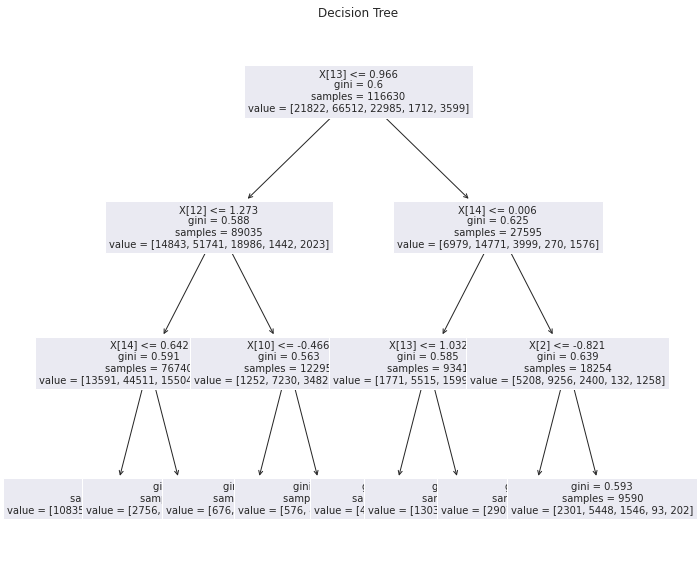

In [ ]:
#plotting a decision tree
from matplotlib import pyplot as plt
from sklearn import tree
fig = plt.figure(figsize=(10,10))
tree.plot_tree(clf_dc, fontsize=10)
plt.title("Decision Tree")
plt.show()


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.



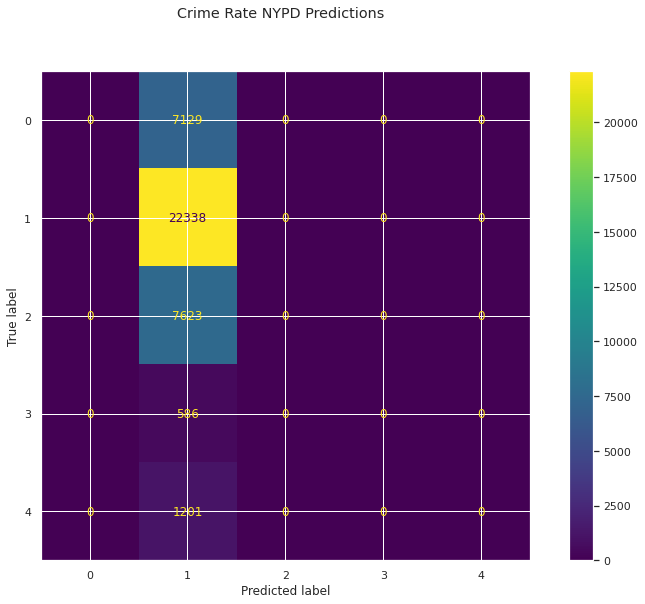

In [ ]:
#plotting the confusion matrix for the decision tree classifer model
from sklearn.metrics import plot_confusion_matrix
from sklearn.metrics import classification_report
fig = plot_confusion_matrix(clf_dc,x_test, y_test, display_labels=clf_dc.classes_)
fig.figure_.suptitle("Crime Rate NYPD Predictions ")
plt.show()

#4. Implementation and Performance Evaluation of all Models

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



2022-06-17 23:03:45.998862
Accuracy Score for the models are: 
LogisticRegression 0.5745813720194459
GaussianNB 0.5665303392751498
MLP Classifier 0.5747357049155027
RandomForestClassifier 0.5895773850862978
KNeighborsClassifier 0.5750958150063019
Classification Report for the models are: 
LogisticRegression               precision    recall  f1-score   support

           0       0.00      0.00      0.00      7129
           1       0.57      1.00      0.73     22338
           2       0.00      0.00      0.00      7623
           3       0.00      0.00      0.00       586
           4       0.00      0.00      0.00      1201

    accuracy                           0.57     38877
   macro avg       0.11      0.20      0.15     38877
weighted avg       0.33      0.57      0.42     38877

GaussianNB               precision    recall  f1-score   support

           0       0.32      0.04      0.07      7129
           1       0.58      0.97      0.72     22338
           2       0.00     

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` param

MLP Classifier               precision    recall  f1-score   support

           0       0.41      0.03      0.05      7129
           1       0.58      0.98      0.73     22338
           2       0.44      0.04      0.07      7623
           3       0.00      0.00      0.00       586
           4       0.33      0.00      0.01      1201

    accuracy                           0.57     38877
   macro avg       0.35      0.21      0.17     38877
weighted avg       0.50      0.57      0.44     38877

RandomForestClassifier               precision    recall  f1-score   support

           0       0.43      0.26      0.32      7129
           1       0.63      0.83      0.72     22338
           2       0.47      0.27      0.34      7623
           3       0.31      0.07      0.11       586
           4       0.54      0.29      0.37      1201

    accuracy                           0.59     38877
   macro avg       0.48      0.34      0.37     38877
weighted avg       0.56      0.59      

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



KNeighborsClassifier -0.02924168813328243

	 RMSE 

LogisticRegression 0.8472169600585251
GaussianNB 0.8738645030489677
MLP Classifier 0.856306785746308
RandomForestClassifier 0.9008088839022863
KNeighborsClassifier 0.8484456797624554

	 MSE 

LogisticRegression 0.7177765774108085
GaussianNB 0.7636391696890192
MLP Classifier 0.7332613113151735
RandomForestClassifier 0.8114566453172827
KNeighborsClassifier 0.7198600715075751

	 MAE 

LogisticRegression 0.5022764102168377
GaussianNB 0.5202047483087687
MLP Classifier 0.505311623839288
RandomForestClassifier 0.5122566041618437
KNeighborsClassifier 0.502507909560923


No handles with labels found to put in legend.


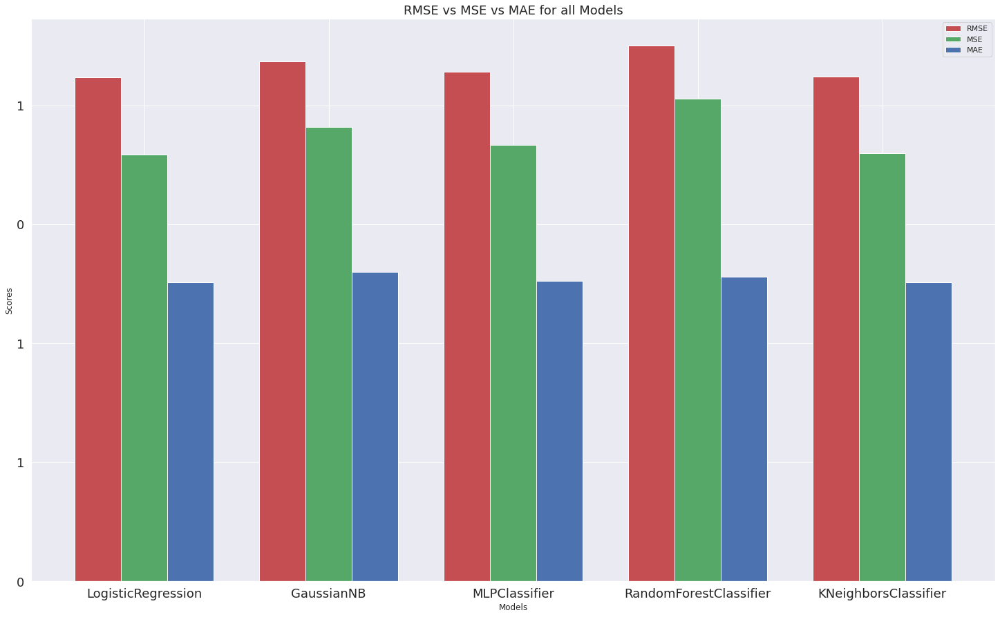

In [ ]:
from sklearn.model_selection import train_test_split
# import multiple model libraries
from sklearn.linear_model import LogisticRegression 
from sklearn.svm import LinearSVC
from sklearn.neighbors import KNeighborsClassifier  
from sklearn.ensemble import RandomForestClassifier 
from sklearn.naive_bayes import GaussianNB
from sklearn.neural_network import MLPClassifier


#import the Model Metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import roc_auc_score
from sklearn.metrics import r2_score as r2
from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import mean_absolute_error as mae
import math

import matplotlib.pyplot as plt 

#initializing array
lr={}
gnb={}
mlp={}
rfc={}
classifier={}
regr_1={}
regr_2={}
import datetime 
datetime.datetime.now() 

for i in range(0, 1):

    # Creating the classifiers

    lr[i] = LogisticRegression(C=20,random_state= 82).fit(x_train, y_train).predict(x_test)
    gnb[i] = GaussianNB().fit(x_train,y_train).predict(x_test)
    mlp[i]= MLPClassifier(random_state=42).fit(x_train, y_train).predict(x_test)
    rfc[i] = RandomForestClassifier(n_estimators= 700).fit(x_train, y_train).predict(x_test)
    classifier[i] = KNeighborsClassifier(n_neighbors=500).fit(x_train, y_train).predict(x_test)  

    print(datetime.datetime.now())
    print("Accuracy Score for the models are: ")

    print('LogisticRegression',accuracy_score(y_test,lr[i]))
    print('GaussianNB',accuracy_score(y_test,gnb[i]))
    print('MLP Classifier',accuracy_score(y_test,mlp[i]))
    print('RandomForestClassifier',accuracy_score(y_test,rfc[i]))
    print('KNeighborsClassifier',accuracy_score(y_test,classifier[i]))

    print("Classification Report for the models are: ")

    print('LogisticRegression',classification_report(y_test,lr[i]))
    print('GaussianNB',classification_report(y_test,gnb[i]))
    print('MLP Classifier',classification_report(y_test,mlp[i]))
    print('RandomForestClassifier',classification_report(y_test,rfc[i]))
    print('KNeighborsClassifier',classification_report(y_test,classifier[i]))

    print("Confusion Matrix Report for the models are: ")  

    print('LogisticRegression\n',confusion_matrix(y_test,lr[i]))
    print('GaussianNB\n',confusion_matrix(y_test,gnb[i]))
    print('MLP Classifier\n',confusion_matrix(y_test,mlp[i]))
    print('RandomForestClassifier\n',confusion_matrix(y_test,rfc[i]))
    print('KNeighborsClassifier\n',confusion_matrix(y_test,classifier[i]))
    
    print("\n\t R2 \n")
    print('LogisticRegression',r2(y_test,lr[i]))
    print('GaussianNB',r2(y_test,gnb[i]))
    print('MLP Classifier',r2(y_test,mlp[i]))
    print('RandomForestClassifier',r2(y_test,rfc[i]))
    print('KNeighborsClassifier',r2(y_test,classifier[i]))

    print("\n\t RMSE \n")
    lrrmse = math.sqrt(mse(y_test,lr[i]))
    gnbrmse = math.sqrt(mse(y_test,gnb[i]))
    mlprmse = math.sqrt(mse(y_test,mlp[i]))
    rfcrmse = math.sqrt(mse(y_test,rfc[i]))
    knnrmse = math.sqrt(mse(y_test,classifier[i]))
    print('LogisticRegression',lrrmse)
    print('GaussianNB',gnbrmse)
    print('MLP Classifier',mlprmse)
    print('RandomForestClassifier',rfcrmse)
    print('KNeighborsClassifier',knnrmse)
       
    print("\n\t MSE \n")
    lrmse = mse(y_test,lr[i])
    gnbmse = mse(y_test,gnb[i])
    mlpmse = mse(y_test,mlp[i])
    rfcmse = mse(y_test,rfc[i])
    knnmse = mse(y_test,classifier[i])
    print('LogisticRegression',lrmse)
    print('GaussianNB',gnbmse)
    print('MLP Classifier',mlpmse)
    print('RandomForestClassifier',rfcmse)
    print('KNeighborsClassifier',knnmse)

    print("\n\t MAE \n")
    lrmae = mae(y_test,lr[i])
    gnbmae = mae(y_test,gnb[i])
    mlpmae = mae(y_test,mlp[i])
    rfcmae = mae(y_test,rfc[i])
    knnmae = mae(y_test,classifier[i])
    print('LogisticRegression',lrmae)
    print('GaussianNB',gnbmae)
    print('MLP Classifier',mlpmae)
    print('RandomForestClassifier',rfcmae)
    print('KNeighborsClassifier',knnmae)

    N = 5
    ind = np.arange(N) 
    width = 0.25
    f, ax = plt.subplots(figsize=(25,15))

    allrmsemodelval = np.array([0.001,0.002,0.003,0.004,0.005],dtype=float) 
    allrmsemodelval[0] = lrrmse
    allrmsemodelval[1] = gnbrmse
    allrmsemodelval[2] = mlprmse
    allrmsemodelval[3] = rfcrmse
    allrmsemodelval[4] = knnrmse
    bar1 = plt.bar(ind, allrmsemodelval, width, color = 'r')
  
    allmsemodelval = np.array([0.001,0.002,0.003,0.004,0.005],dtype=float)
    allmsemodelval[0] = lrmse
    allmsemodelval[1] = gnbmse
    allmsemodelval[2] = mlpmse
    allmsemodelval[3] = rfcmse
    allmsemodelval[4] = knnmse 
    bar2 = plt.bar(ind+width, allmsemodelval, width, color='g')
  
    allmaemodelval = np.array([0.001,0.002,0.003,0.004,0.005],dtype=float)
    allmaemodelval[0] = lrmae
    allmaemodelval[1] = gnbmae
    allmaemodelval[2] = mlpmae
    allmaemodelval[3] = rfcmae
    allmaemodelval[4] = knnmae    
    bar3 = plt.bar(ind+width*2, allmaemodelval, width, color = 'b')

    plt.xlabel("Models")
    plt.ylabel('Scores')
    plt.title("RMSE vs MSE vs MAE for all Models", fontsize=18)
    
    ax.set_xticklabels(x, fontsize=18)
    ax.set_yticklabels(y, fontsize=18)
    plt.yticks(fontsize=18)
    plt.legend(fontsize = 18)

    plt.xticks(ind+width,['LogisticRegression', 'GaussianNB', 'MLPClassifier', 'RandomForestClassifier', 'KNeighborsClassifier'])
    plt.legend( (bar1, bar2, bar3), ('RMSE', 'MSE', 'MAE') )
    plt.show()

In [ ]:
from sklearn.tree import DecisionTreeClassifier

#Model DecisionTreeClassifier to fit training sets for input and output
clf = DecisionTreeClassifier()
clf = clf.fit(x_train,y_train)

y_predict = clf.predict(x_test)

In [ ]:
#finding effective alpha value along with impurities (Hyper-parameter tuning technique)
path = clf.cost_complexity_pruning_path(x_train,y_train)

ccp_alphas, impurities = path.ccp_alphas, path.impurities

In [ ]:
ccp_alphas

array([0.00000000e+00, 2.44974951e-06, 2.85804110e-06, ...,
       1.27601809e-03, 1.27846576e-03, 2.78603767e-03])

In [ ]:
impurities

array([1.28611849e-04, 1.35961098e-04, 1.38819139e-04, ...,
       5.94420528e-01, 5.96977460e-01, 5.99763498e-01])

Text(0.5, 1.0, 'Total Impurity vs effective alpha for training set')

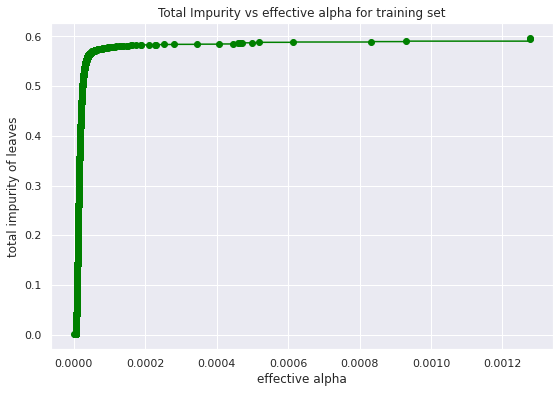

In [ ]:
#maximum effective alpha value is removed
fig, ax = plt.subplots()
fig.set_size_inches(9, 6)
ax.plot(ccp_alphas[:-1], impurities[:-1], marker='o', drawstyle="steps-post", color="green")
ax.set_xlabel("effective alpha")
ax.set_ylabel("total impurity of leaves")
ax.set_title("Total Impurity vs effective alpha for training set")

#5. Result (Checking actual vs predicted values)

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier as KNN

In [ ]:
knn = KNN(n_neighbors = 3)

# train the model
knn.fit(x_train, y_train)

print('Model is Created')

Model is Created


In [ ]:
y_pred = knn.predict(x_test)

y_pred

array([1, 1, 1, ..., 1, 2, 2])

In [ ]:
#confusion matrix for KNN Model
cf_matrix = confusion_matrix(y_test, y_pred)

print(cf_matrix)

[[ 2477  3911   617    12   112]
 [ 4842 14932  2373    44   147]
 [ 1453  4206  1894    24    46]
 [  112   345   105    19     5]
 [  371   574    75     1   180]]


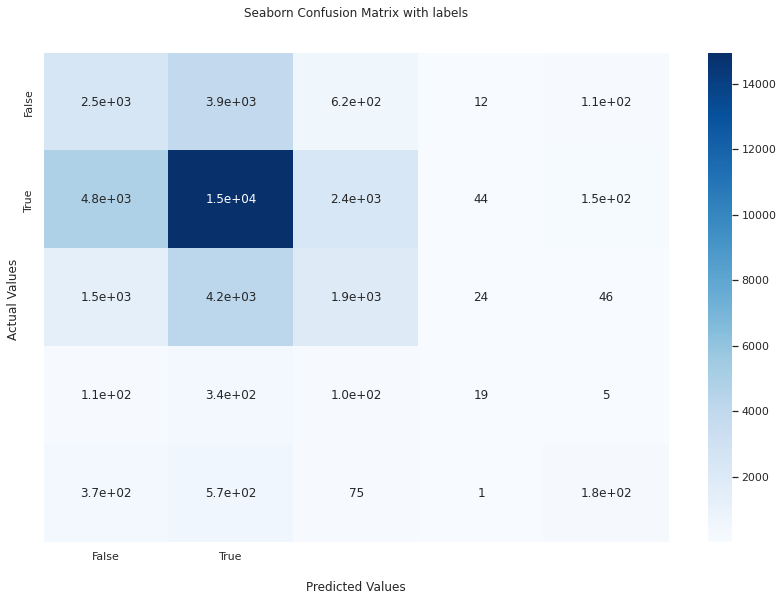

In [ ]:
#plotting the confusion matrix for the KNN Model
import seaborn as sns

ax = sns.heatmap(cf_matrix, annot=True, cmap='Blues')

ax.set_title('Seaborn Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ');

## Ticket labels - List must be in alphabetical order
ax.xaxis.set_ticklabels(['False','True'])
ax.yaxis.set_ticklabels(['False','True'])

## Display the visualization of the Confusion Matrix.
plt.show()

In [ ]:
#Best Model (RandomForestClassifier) performance check
from sklearn.ensemble import RandomForestClassifier
Random=RandomForestClassifier()
Random.fit(x_train, y_train)

print('Model is Created')

Model is Created


In [ ]:
y_pred1 = Random.predict(x_test)

y_pred1

array([1, 1, 1, ..., 2, 1, 0])

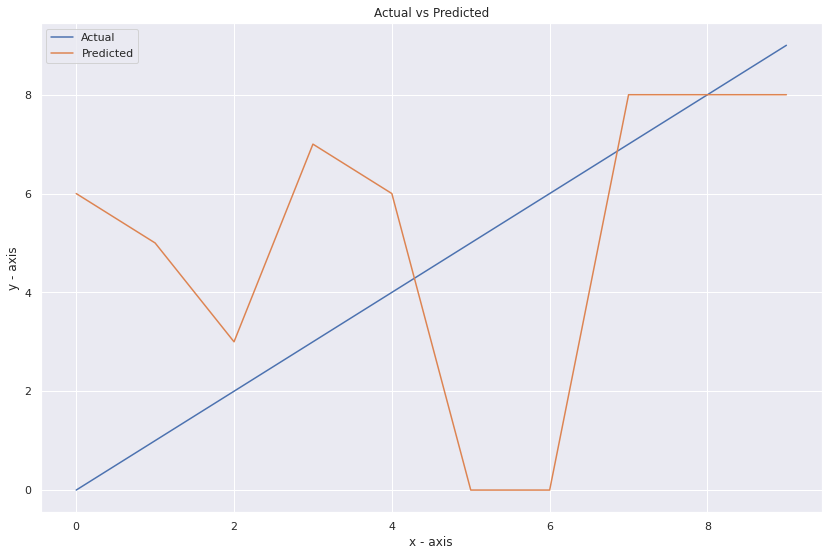

In [ ]:
#plotting a line chart of the Actual vs predicted values for RandomForestClassier Model
import matplotlib.pyplot as plt


# plotting the line 1 points 
plt.plot(y_test, label = "Actual")

# plotting the line 2 points 
plt.plot(y_pred1, label = "Predicted")
plt.xlabel('x - axis')
# Set the y axis label of the current axis.
plt.ylabel('y - axis')
# Set a title of the current axes.
plt.title('Actual vs Predicted')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [ ]:
#confusion matrix of the RandomForestClassifier
cf_matrix1 = confusion_matrix(y_test, y_pred1)

print(cf_matrix1)

[[ 1864  4662   443    14   146]
 [ 1886 18468  1828    40   116]
 [  437  5044  2080    37    25]
 [   29   396   120    40     1]
 [  229   580    47     1   344]]


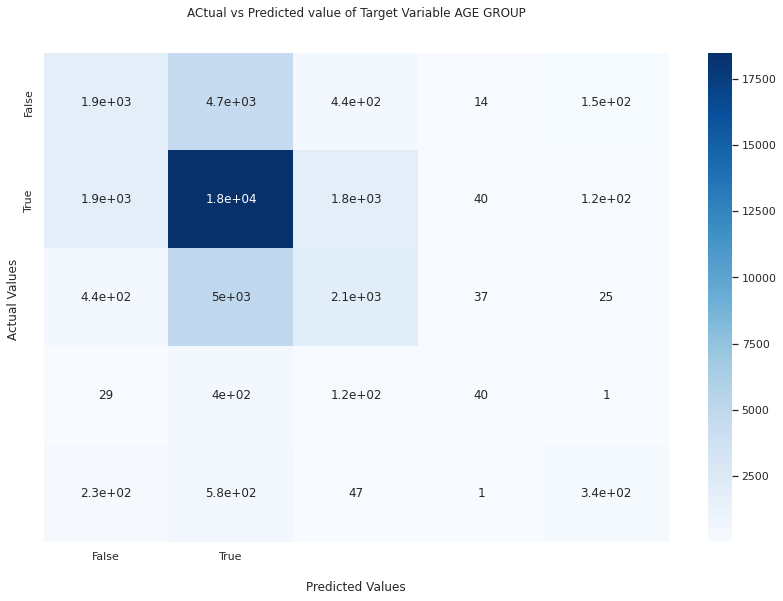

In [ ]:
#plot the confusion matrix for the RandomForestClassifier Model
import seaborn as sns

ax = sns.heatmap(cf_matrix1, annot=True, cmap='Blues')

ax.set_title('ACtual vs Predicted value of Target Variable AGE GROUP\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ');

## Ticket labels - List must be in alphabetical order
ax.xaxis.set_ticklabels(['False','True'])
ax.yaxis.set_ticklabels(['False','True'])

## Display the visualization of the Confusion Matrix.
plt.show()

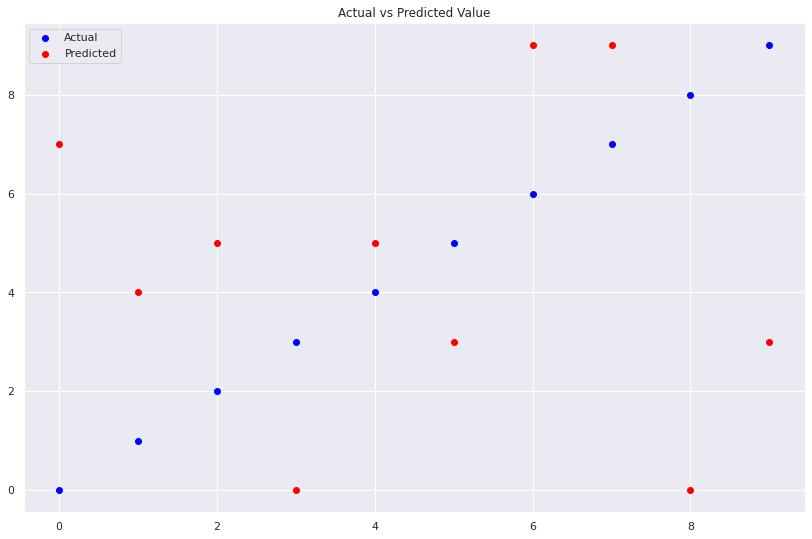

In [ ]:
#plotting a scatter plot matrix of the Actual and predicted values for the RandomForestClassifier Model
import matplotlib.pyplot as plt
import numpy as np


def plotGraph(y_test,y_pred1,regressorName):
    if max(y_test) >= max(y_pred1):
        my_range = int(max(y_test))
    else:
        my_range = int(max(y_pred1))
    plt.scatter(range(len(y_test)), y_test, color='blue')
    plt.scatter(range(len(y_pred1)), y_pred1, color='red')
    plt.title(regressorName)
    plt.legend(['Actual','Predicted'])
    plt.show()
    return


y_test = range(10)
y_pred1 = np.random.randint(0, 10, 10)


plotGraph(y_test, y_pred1, "Actual vs Predicted Value")